In [1]:
#必要ライブラリのインポート
import os
import numpy as np
import geopandas as gpd
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
matplotlib.rcParams['figure.dpi'] = 300 # 解像度
import folium
import zipfile
import glob
import shutil
import cartopy, fiona, shapely, pyproj, rtree, pygeos
import cv2
import rasterio as rio
from rasterio import plot
from rasterio.plot import show
from rasterio.plot import plotting_extent
from rasterio.mask import mask
# from sentinelsat import SentinelAPI, read_geojson, geojson_to_wkt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from shapely.geometry import MultiPolygon, Polygon
from osgeo import gdal

import urllib
from satsearch import Search
from pystac_client import Client
from PIL import Image
import requests
import io
from pystac_client import Client
import warnings
warnings.filterwarnings('ignore')

print("done")

done


In [2]:
import sys
sys.path.append('/workspace/src')

In [3]:
from lib import selSquare

# 鹿児島市市周辺の緯度経度をbbox内へ
geometry = selSquare(130.53, 31.60, 0.06, 0.02)
timeRange = '2019-01-01/2020-12-31' # 取得時間範囲を指定

In [4]:
api_url = 'https://earth-search.aws.element84.com/v0'
collection = "sentinel-s2-l2a-cogs"  # Sentinel-2, Level 2A (BOA)
s2STAC = Client.open(api_url, headers=[])
s2STAC.add_conforms_to("ITEM_SEARCH")

s2Search = s2STAC.search ( 
    intersects = geometry,
    datetime = timeRange,
    query = {"eo:cloud_cover": {"lt": 10}, "sentinel:valid_cloud_cover": {"eq": True}},
    collections = collection)

s2_items = [i.to_dict() for i in s2Search.get_items()]
print(f"{len(s2_items)} のシーンを取得")

64 のシーンを取得


In [5]:
items = s2Search.get_all_items()
df = gpd.GeoDataFrame.from_features(items.to_dict(), crs="epsg:32652")
dfSorted = df.sort_values('eo:cloud_cover').reset_index(drop=True)
dfSorted.head()

,geometry,created,sentinel:product_id,sentinel:sequence,view:off_nadir,sentinel:valid_cloud_cover,platform,sentinel:utm_zone,proj:epsg,sentinel:grid_square,datetime,instruments,constellation,eo:cloud_cover,gsd,sentinel:latitude_band,sentinel:data_coverage,updated,data_coverage
0,"POLYGON ((131.210 31.528, 130.053 31.542, 130....",2020-08-18T23:02:38.459Z,S2B_MSIL2A_20200511T015701_N0214_R031_T52SFA_2...,0,0,True,sentinel-2b,52,32652,FA,2020-05-11T02:08:41Z,[msi],sentinel-2,0.01,10,S,100,2020-08-18T23:02:38.459Z,NaN
1,"POLYGON ((131.189 30.626, 130.044 30.641, 130....",2020-09-21T13:41:55.349Z,S2B_MSIL2A_20200206T015839_N0214_R060_T52RFV_2...,0,0,True,sentinel-2b,52,32652,FV,2020-02-06T02:08:45Z,[msi],sentinel-2,0.01,10,R,100,2020-09-21T13:41:55.349Z,100.0
2,"POLYGON ((131.210 31.528, 130.053 31.542, 130....",2020-08-19T00:31:29.236Z,S2A_MSIL2A_20200511T015701_N0214_R060_T52SFA_2...,1,0,True,sentinel-2a,52,32652,FA,2020-05-11T02:08:41Z,[msi],sentinel-2,0.01,10,S,100,2020-08-19T00:31:29.236Z,NaN
3,"POLYGON ((131.210 31.528, 130.053 31.542, 130....",2020-08-23T12:49:49.903Z,S2B_MSIL2A_20190919T015649_N0213_R060_T52SFA_2...,0,0,True,sentinel-2b,52,32652,FA,2019-09-19T02:08:35Z,[msi],sentinel-2,0.02,10,S,100,2020-08-23T12:49:49.903Z,NaN
4,"POLYGON ((131.189 30.626, 130.044 30.641, 130....",2020-09-21T05:59:54.601Z,S2B_MSIL2A_20191009T015659_N0213_R060_T52RFV_2...,0,0,True,sentinel-2b,52,32652,FV,2019-10-09T02:08:52Z,[msi],sentinel-2,0.05,10,R,100,2020-09-21T05:59:54.601Z,100.0


In [6]:
from lib import sel_items

selected_item, thumbUrl = sel_items(items, dfSorted['sentinel:product_id'][0])
print(thumbUrl)
print(selected_item)

['https://roda.sentinel-hub.com/sentinel-s2-l1c/tiles/52/S/FA/2020/5/11/0/preview.jpg']
[{'thumbnail': <Asset href=https://roda.sentinel-hub.com/sentinel-s2-l1c/tiles/52/S/FA/2020/5/11/0/preview.jpg>, 'overview': <Asset href=https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/52/S/FA/2020/5/S2B_52SFA_20200511_0_L2A/L2A_PVI.tif>, 'info': <Asset href=https://roda.sentinel-hub.com/sentinel-s2-l2a/tiles/52/S/FA/2020/5/11/0/tileInfo.json>, 'metadata': <Asset href=https://roda.sentinel-hub.com/sentinel-s2-l2a/tiles/52/S/FA/2020/5/11/0/metadata.xml>, 'visual': <Asset href=https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/52/S/FA/2020/5/S2B_52SFA_20200511_0_L2A/TCI.tif>, 'B01': <Asset href=https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/52/S/FA/2020/5/S2B_52SFA_20200511_0_L2A/B01.tif>, 'B02': <Asset href=https://sentinel-cogs.s3.us-west-2.amazonaws.com/sentinel-s2-l2a-cogs/52/S/FA/2020/5/S2B_52SFA_20200511_0_L2A/B02.tif>, 'B03': <Asse

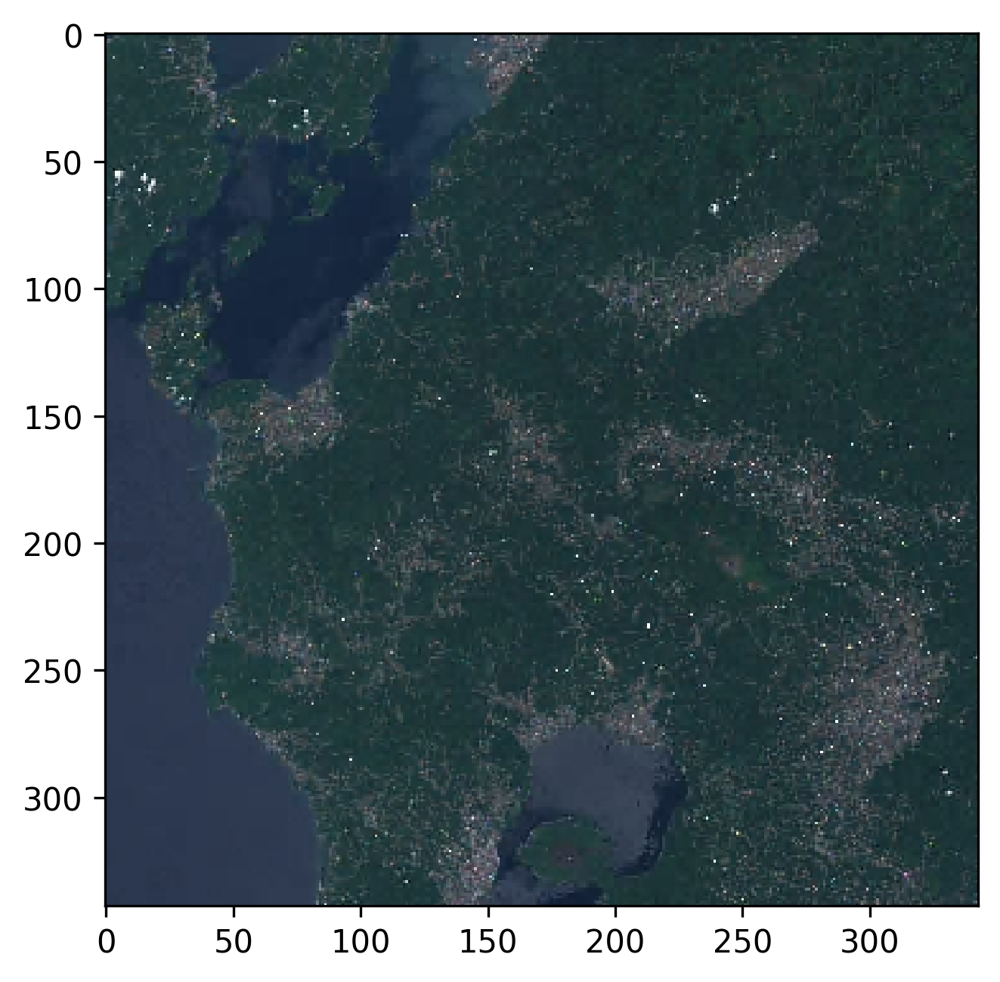

In [7]:
thumbImg = Image.open(io.BytesIO(requests.get(thumbUrl[0]).content))
plt.figure(figsize=(5,5))
plt.imshow(thumbImg)

In [8]:
# Sentinel-2のバンド情報を表で示す
import rich.table

table = rich.table.Table("Asset Key", "Description")
for asset_key, asset in selected_item[0].items():
  table.add_row(asset_key, asset.title)

table

┏━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Asset Key ┃ Description                     ┃
┡━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ thumbnail │ Thumbnail                       │
│ overview  │ True color image                │
│ info      │ Original JSON metadata          │
│ metadata  │ Original XML metadata           │
│ visual    │ True color image                │
│ B01       │ Band 1 (coastal)                │
│ B02       │ Band 2 (blue)                   │
│ B03       │ Band 3 (green)                  │
│ B04       │ Band 4 (red)                    │
│ B05       │ Band 5                          │
│ B06       │ Band 6                          │
│ B07       │ Band 7                          │
│ B08       │ Band 8 (nir)                    │
│ B8A       │ Band 8A                         │
│ B09       │ Band 9                          │
│ B11       │ Band 11 (swir16)                │
│ B12       │ Band 12 (swir22)                │
│ AOT       │ Aerosol Optical Thickness (AOT) │
│ WVP       │ Water Vapour (WVP)              │
│ SCL       │ Scene Classification Map (SCL)  │
└───────────┴─────────────────────────────────┘

In [10]:
from lib import download_file_to_dir

# 画像を保存するディレクトリの作成
os.makedirs('../outputs/s2Bands',exist_ok=True)

# 取得するバンドの選択
bandLists = ['B11','B08','B04','B03','B02'] # SWIR, NIR, RED, GREEN, BLUE

# 画像のURL取得
file_url = []
[file_url.append(selected_item[0][band].href) for band in bandLists if file_url.append(selected_item[0][band].href) is not None]

# 画像のダウンロード
dst_dir = '../outputs/s2Bands'
[download_file_to_dir(link, dst_dir) for link in file_url if download_file_to_dir(link, dst_dir) is not None]

[]

In [9]:
# ライブラリのインポート
import earthpy as et
import earthpy.spatial as es
import earthpy.plot as ep
import xarray as xr
import rioxarray as rxr

In [11]:
# TIFデータのパス指定
land_paths = glob.glob(os.path.join("../outputs/s2Bands","*.tif"))
# バンド順に並び替え
land_paths.sort()
land_paths

['../outputs/s2Bands/B02.tif',
 '../outputs/s2Bands/B03.tif',
 '../outputs/s2Bands/B04.tif',
 '../outputs/s2Bands/B08.tif',
 '../outputs/s2Bands/B11.tif']

In [12]:
# 近赤外のバンド情報を示す
b08_href = selected_item[0]["B08"].href
b08 = rxr.open_rasterio(b08_href, masked=True)
print(b08)

<xarray.DataArray (band: 1, y: 10980, x: 10980)> Size: 482MB
[120560400 values with dtype=float32]
Coordinates:
  * band         (band) int64 8B 1
  * x            (x) float64 88kB 6e+05 6e+05 6e+05 ... 7.098e+05 7.098e+05
  * y            (y) float64 88kB 3.6e+06 3.6e+06 3.6e+06 ... 3.49e+06 3.49e+06
    spatial_ref  int64 8B 0
Attributes:
    AREA_OR_POINT:       Area
    OVR_RESAMPLING_ALG:  AVERAGE
    scale_factor:        1.0
    add_offset:          0.0


In [14]:
# 行政区域データをダウンロードするフォルダの作成
os.makedirs('../outputs/kagoshimaPolygon',exist_ok=True)

# wgetを行う
!wget --restrict-file-names=nocontrol \
     --content-disposition \
     --user-agent="Mozilla/5.0 (Windows NT 10.0; Win64; x64; rv:52.0) Gecko/20100101 Firefox/52.0" \
     "https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2019/N03-190101_46_GML.zip" \
     -P ../outputs/kagoshimaPolygon

import zipfile

# ダウンロードしたファイルを展開する
with zipfile.ZipFile('../outputs/kagoshimaPolygon/N03-190101_46_GML.zip') as zipf:
  for zinfo in zipf.infolist():        # ZipInfoオブジェクトを取得
      if not zinfo.flag_bits & 0x800:  # flag_bitsプロパティで文字コードを取得
          # 文字コードが(cp437)だった場合はcp932へ変換する
          # strオブジェクトのプロパティencode/decodeでcp932に変換
          # 変換後のファイル名をfilenameプロパティで再度し直す
          zinfo.filename = zinfo.filename.encode('cp437').decode('cp932')
          if os.sep != "/" and os.sep in zinfo.filename:
            zinfo.filename = zinfo.filename.replace(os.sep, "/")

      zipf.extract(zinfo, '../outputs/kagoshimaPolygon')

--2024-03-22 03:45:55--  https://nlftp.mlit.go.jp/ksj/gml/data/N03/N03-2019/N03-190101_46_GML.zip
Resolving nlftp.mlit.go.jp (nlftp.mlit.go.jp)... 192.29.39.98, 192.29.43.211, 192.29.39.162
Connecting to nlftp.mlit.go.jp (nlftp.mlit.go.jp)|192.29.39.98|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20964085 (20M) [application/zip]
Saving to: ‘../outputs/kagoshimaPolygon/N03-190101_46_GML.zip’

N03-190101_46_GML.z 100%[===================>]  19.99M  7.89MB/s    in 2.5s    

2024-03-22 03:45:58 (7.89 MB/s) - ‘../outputs/kagoshimaPolygon/N03-190101_46_GML.zip’ saved [20964085/20964085]



In [15]:
#ダウンロードしたデータを解凍して、ディレクトリを指定
shape_path = "../outputs/kagoshimaPolygon/"

# 鹿児島県のshpの読み込み
kagoshimaPref = gpd.read_file(os.path.join(shape_path + "N03-19_46_190101.geojson"),encoding="shift-jis")
kagoshimaCity = kagoshimaPref[kagoshimaPref["N03_004"].isin(["鹿児島市"])] # 鹿児島市でソート
kagoshimaCity = kagoshimaCity.drop(columns=["N03_002","N03_003"]) # 鹿児島市のみを抽出

# 抽出した鹿児島市のポリゴンをSentinel-2のCRSに合わせる
with rio.open(land_paths[0]) as raster_crs:
  raster_profile = raster_crs.profile
  bound_utm52N = kagoshimaCity.to_crs(raster_profile["crs"])

In [16]:
os.makedirs('../outputs/s2Output',exist_ok=True) # outputデータ保存ディレクトリ
output_dir = "../outputs/s2Output"
band_paths_list = es.crop_all(land_paths, output_dir, 
                              bound_utm52N, overwrite=True)

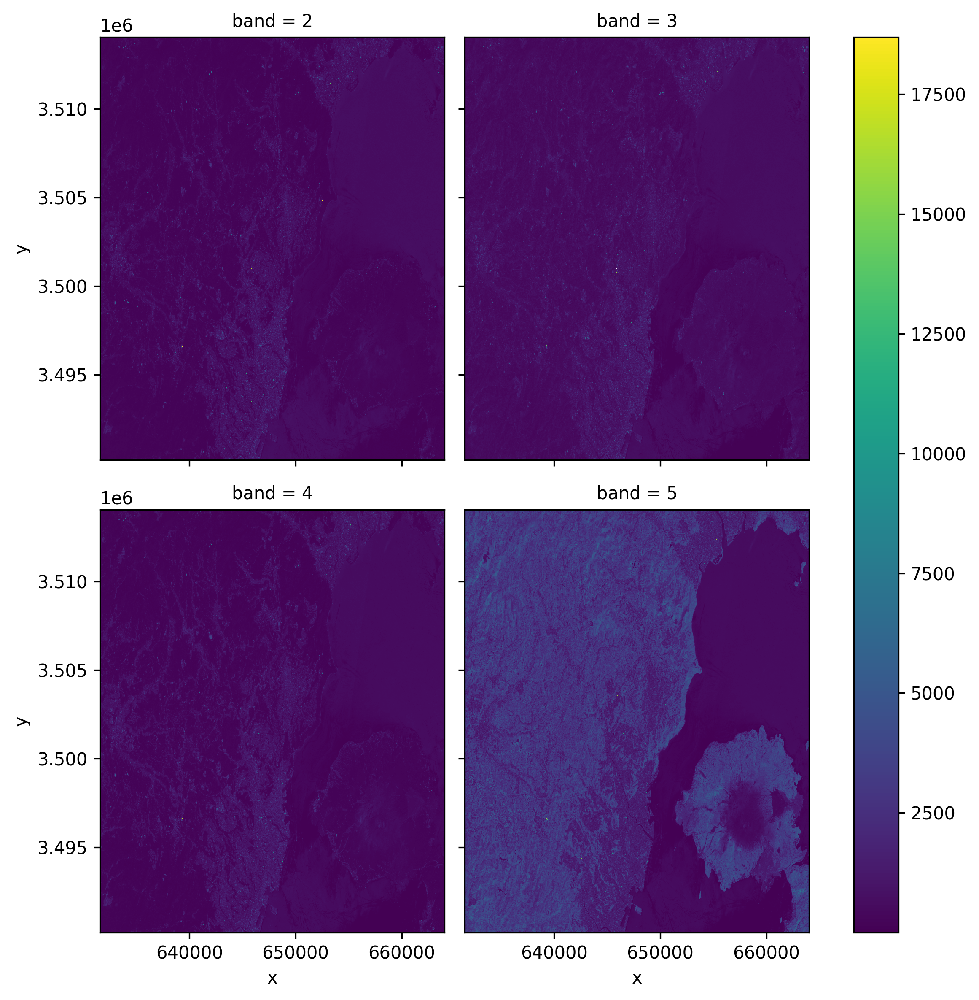

In [17]:
# ループ処理で全てのバンド情報を開く
allBands = []
for i, aband in enumerate(band_paths_list[0:4]):
    allBands.append(rxr.open_rasterio(aband, masked=True).squeeze())
    # バンド数を新しいxarrayオブジェクトとして割り当てる
    allBands[i]["band"]=i+2

# データリストを一つのxarrayオブジェクトへ変換
s2Kagoshima = xr.concat(allBands, dim="band") 

# xarray.plot.imshowで描画
s2Kagoshima.plot.imshow(col="band",
                        col_wrap=2, # 2列で折り返し
                        figsize=(8,8))
plt.show()

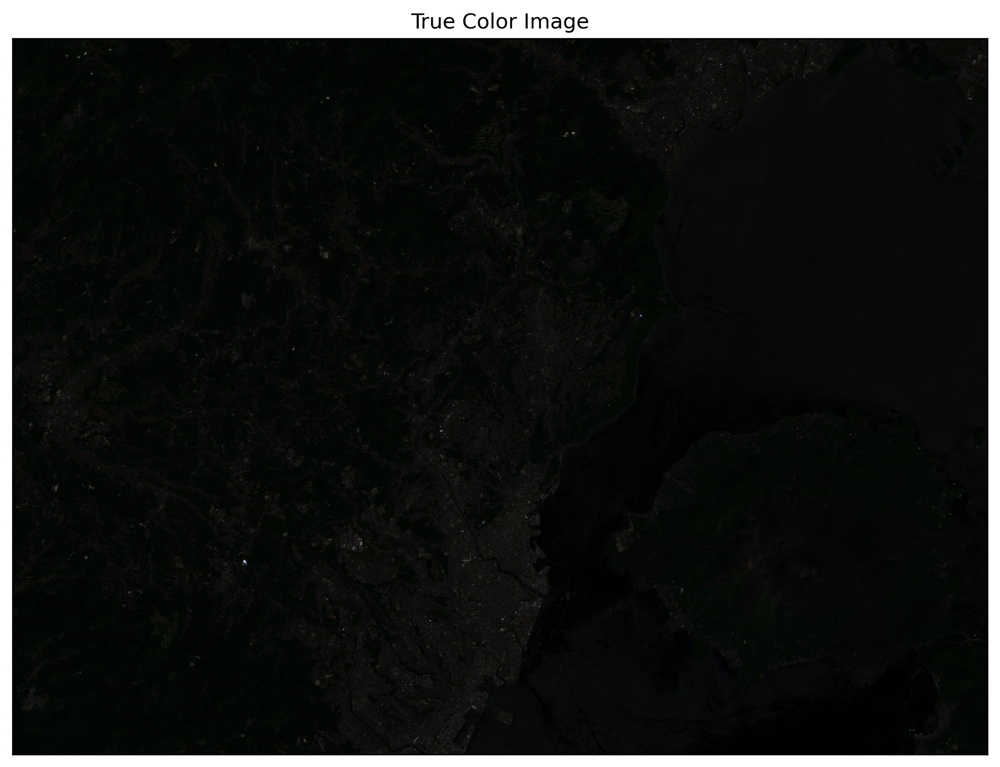

In [18]:
# # xarrayを表示。Coordinates内のbandと示されているところに、どのバンドが含まれているかが示されています
# print(s2Kagoshima)

# xarray中でバンドは2, 3, 4, 5, 6の順番に並んでいますので、RGBの場合には2, 1, 0を割り当てれば良いことがわかります。

ep.plot_rgb(s2Kagoshima.values,
            rgb=[2, 1, 0],
            title="True Color Image")
plt.show()

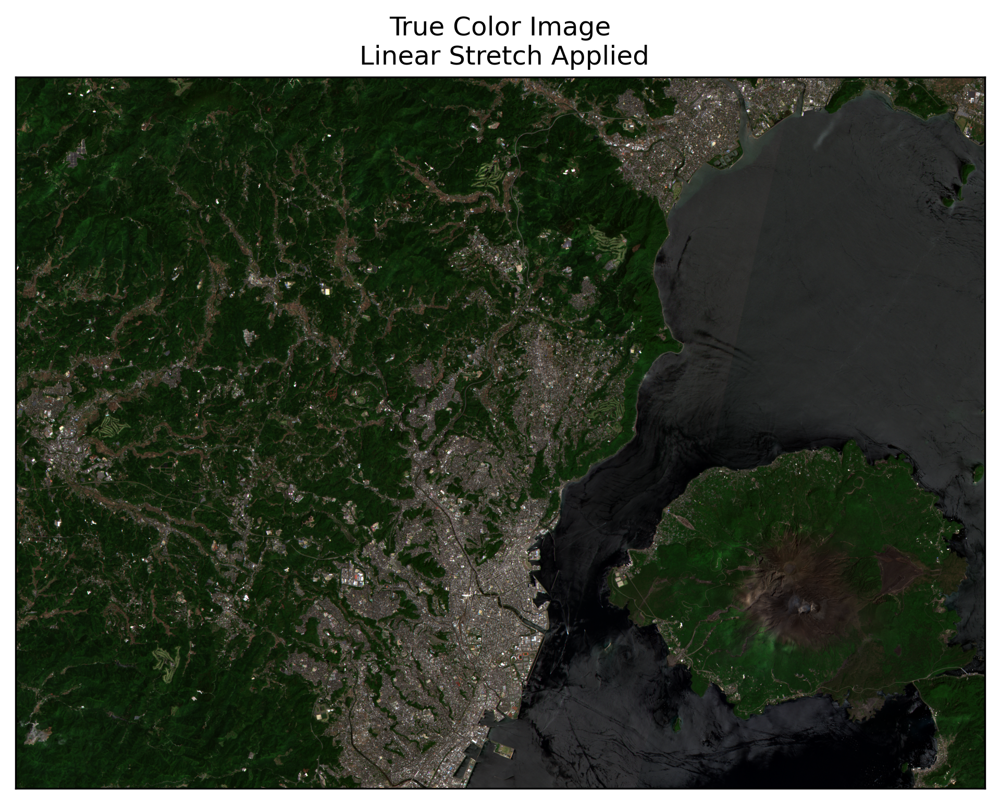

In [19]:
fig, ax = plt.subplots(figsize=(8, 8))

ep.plot_rgb(s2Kagoshima.values,
            rgb=[2, 1, 0],
            ax = ax,
            title="True Color Image\n Linear Stretch Applied",
            stretch=True,
            str_clip = 0.08)
plt.show()

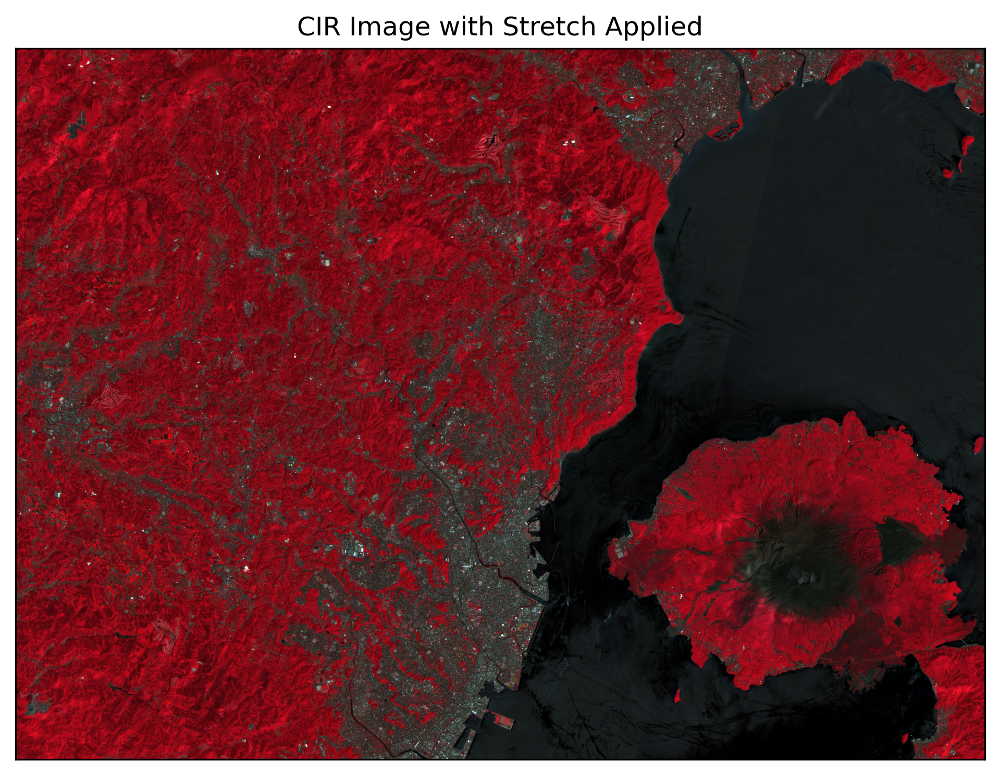

In [20]:
fig, ax = plt.subplots(figsize=(8, 8))

# NIR、赤、緑を組み合わせる
ep.plot_rgb(
    s2Kagoshima.values,
    rgb=(3, 2, 1),
    ax=ax,
    stretch=True,
    str_clip=0.02,
    title="CIR Image with Stretch Applied",
)
plt.show()

In [21]:
cropped_array, array_raster_profile = es.stack(band_paths_list[0:4], nodata=-9999) # データが存在しない場所に-9999を入れます
crop_extent = plotting_extent(
    cropped_array[0], array_raster_profile["transform"] # 切り抜き範囲（描画範囲）とアフィン変換の指定
    )

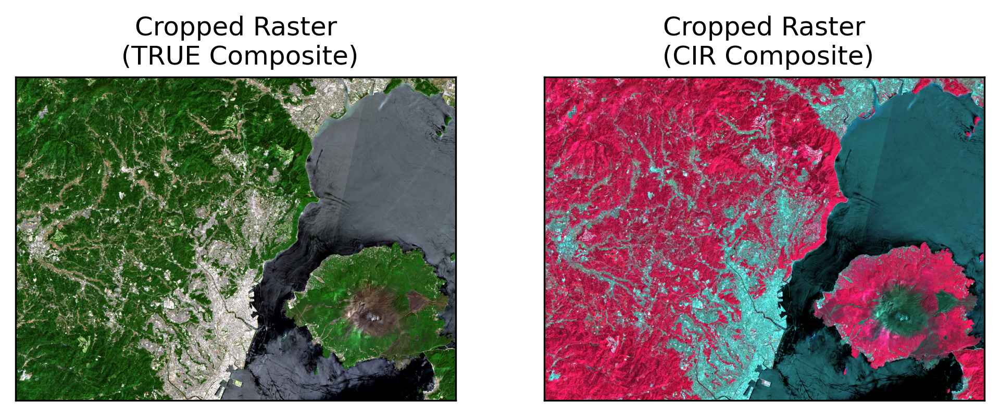

In [22]:
# TRUEとCIRの合成画像を並べて表示
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 8))

# 切り抜き後の画像を出力 (TRUE)
ax1 = ep.plot_rgb(
    cropped_array,
    rgb=(2,1,0),
    ax=ax1,
    stretch=True,
    extent=crop_extent,
    title="Cropped Raster\n (TRUE Composite)",
)

# 切り抜き後の画像を出力 (CIR)
ax2= ep.plot_rgb(
    cropped_array,
    rgb=(3,2,1),
    ax=ax2,
    stretch=True,
    extent=crop_extent,
    title="Cropped Raster\n (CIR Composite)",
)
plt.show()

In [25]:
ndvi = (s2Kagoshima[3] - s2Kagoshima[2]) / (s2Kagoshima[3] + s2Kagoshima[2])
ndviImage = rio.open('../outputs/ndvi.tiff','w',
                     driver='Gtiff',
                     width=s2Kagoshima[2].rio.width,
                     height = s2Kagoshima[2].rio.height,
                     count=1, crs=s2Kagoshima[2].rio.crs,
                     transform=s2Kagoshima[2].rio.transform(),
                     dtype='float64')
ndviImage.write(ndvi,1)
ndviImage.close()

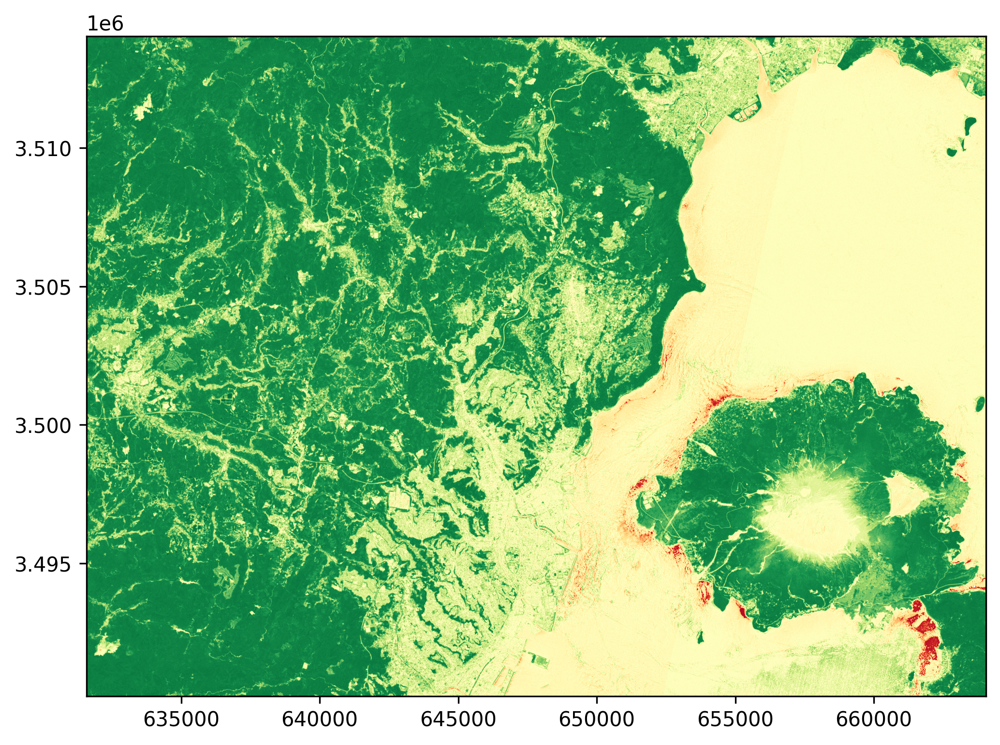

<Axes: >

In [26]:
# 緑の濃い部分ほど、植物が繁茂し、赤色が強いほど、植生がない状態を示します
ndviTif = rio.open('../outputs/ndvi.tiff')
fig = plt.figure(figsize=(8,8))
plot.show(ndviTif, cmap="RdYlGn")

In [27]:
# ファイルの場所は適宜変更
b3 = gdal.Open("../outputs/s2Output/B03_crop.tif")

# resample 10m->20m
# 現在の作業ディレクトリにファイルを保存
dsRes = gdal.Warp("../outputs/s2Output/B03_crop_avg.tif", b3, xRes = 20, yRes = 20, resampleAlg = "average")

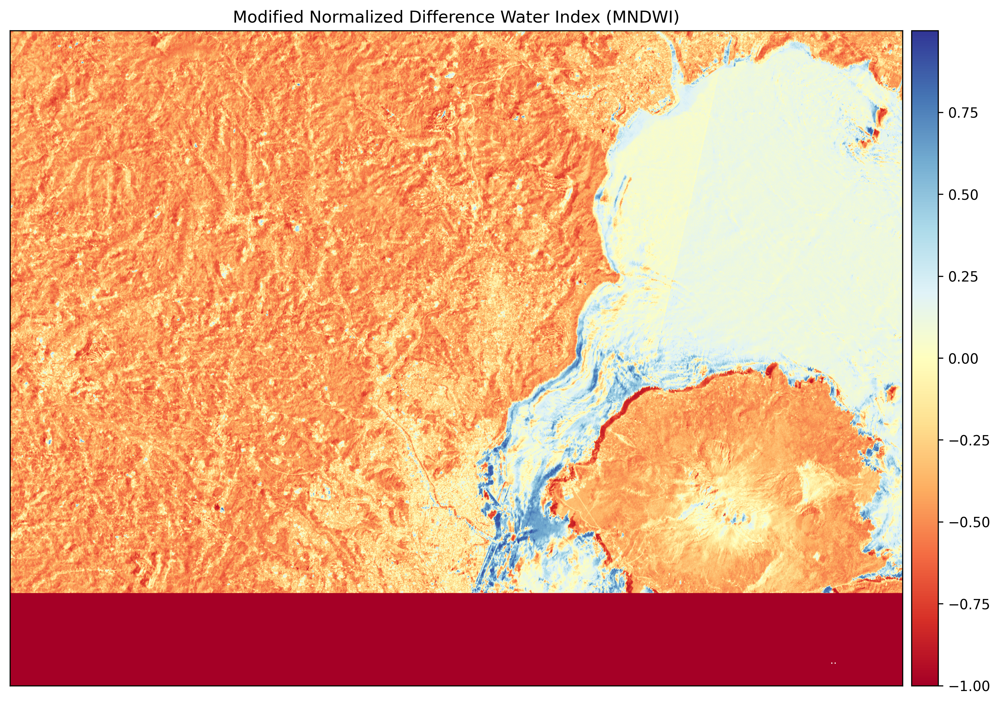

<Axes: title={'center': 'Modified Normalized Difference Water Index (MNDWI)'}>

In [28]:
b3 = rio.open("../outputs/s2Output/B03_crop_avg.tif")
b11 = rio.open("../outputs/s2Output/B11_crop.tif")
green = b3.read(1).astype('float64')
swir = b11.read(1).astype('float64')


mndwi = es.normalized_diff(b1=green, b2=swir) # GreenとSWIRの波長を抽出し、正規化します
ep.plot_bands(mndwi, cmap="RdYlBu", cols=1, title="Modified Normalized Difference Water Index (MNDWI)")
# ep.plot_bands(mndwi, cmap="RdYlBu", cols=1, title="Modified Normalized Difference Water Index (MNDWI)",vmin=-1,vmax=1)